In [170]:
# path 0
import pandas as pd
import numpy as np
import tensorflow as tf
# from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import copy
import sklearn
np.set_printoptions(precision=2, suppress=True)
import seaborn as sns
import scipy as sp
np.random.seed(42)


In [163]:
# path 0

def mnist_data():
    (X_train, Y_train), (X_test, Y_test) = tf.keras.datasets.mnist.load_data()
    # path 0
    df_XY_train_raw = X_train.reshape(60000, 28*28)
    df_XY_train_raw = pd.DataFrame(df_XY_train_raw)
    X_cols = [f'X_{i}' for i in df_XY_train_raw.columns]
    df_XY_train_raw.columns = X_cols
    df_XY_train_raw['Y'] = Y_train
    df_XY_train_raw

    # filter = df_XY_train_raw['Y']<2
    # df_XY_train_raw = df_XY_train_raw[filter]
    Y_t = np.array(df_XY_train_raw['Y'])
    df_y_train = np.zeros((Y_t.size, Y_t.max() + 1))
    df_y_train[np.arange(Y_t.size), Y_t] = 1
    df_y_train = pd.DataFrame(df_y_train)
    Y_cols = {i:f'Y_{i}' for i in df_y_train.columns}
    df_y_train = df_y_train.rename(columns=Y_cols)
    # df_y_train['Y_t'] = Y_t
    # # display(df_y_train)
    # Y_cols = ['Y_t']
    df_XY_train_raw = pd.concat([df_XY_train_raw, df_y_train], axis=1)
    # display(df_XY_train_raw[['Y','Y_t']])
    return df_XY_train_raw, X_cols, Y_cols
    # path 0
    # df_X_train_raw = df_XY_train_raw[X_cols]
    # df_X_train_raw
    # # path 0


    #
    # # df_y_train = df_y_train.head(n_samples)
    # n_y = df_y_train.shape[1]
    # print(n_y)
    # df_y_train
    # return df_X_train_raw, df_y_train, n_y


In [159]:
def hm_x(l_ar, figsize_per_plot=(4, 4),titles=[]):
    l_df = [pd.DataFrame(i) for i in l_ar]
    sizes = [[df.shape[1],df.shape[0]] for df in l_df]
    s_x = [i[0] for i in sizes]
    s_x = sum(s_x)
    s_y = [i[1] for i in sizes]
    s_y = np.mean(s_y)
    # size = [df.shape[1]*0.6,df.shape[0]*0.35]
    n = len(l_ar)
    wr = [i[0] for i in sizes]
    # print(n,s_x,s_y,sizes,wr)

    fig, axes = plt.subplots(1, n, figsize=(s_x*0.6, s_y*0.35),width_ratios=wr,)
    # If only one subplot, axes is not iterable — fix that
    if n == 1:
        axes = [axes]
    if titles:
        for i, ax in enumerate(axes):
            ax.set_title(titles[i])
    for i, df in enumerate(l_df):
        ax = axes[i]
        sns.heatmap(df, annot=True, fmt=".1f", cmap="coolwarm",
                cbar=False, ax=ax, annot_kws={"size": 8,'color':'black'},
                xticklabels=False,yticklabels=False,
                )
        # ax.set_title(f"Figure {i+1}")
        # ax.xaxis.tick_top()


    # plt.tight_layout()
    # return fig
    # plt.tight_layout()
    plt.show()
def hm_nn(lay):
    ws = [pd.DataFrame(i) for i in lay['w']]
    bs = [pd.DataFrame(i) for i in lay['b']]

    len_w = [i.shape[1] for i in bs]
    width = sum(len_w)
    # print(width,len_w)

    len_h = [i.shape[0] for i in ws]
    height = max(len_h)+1
    hr = [1,height]
    # print(len_h)



    # print(lay)
    fig, axes = plt.subplots(2, len(bs),figsize=(width*0.6, height*0.35),width_ratios=len_w,height_ratios=hr)
    # If only one subplot, axes is not iterable — fix that
    if len(bs) == 1:
        axes = [[axes[0]],[axes[1]]]
    # print(axes)

    for ax, df in zip(axes[0],bs):
        sns.heatmap(df, annot=True, fmt=".1f", cmap="coolwarm",
                cbar=False, ax=ax, annot_kws={"size": 8,'color':'black'},
                xticklabels=False,yticklabels=False,
                )
    for ax, df in zip(axes[1],ws):
        # print(df.shape[0], )
        n = height-df.shape[0]-1

        empty = pd.DataFrame(np.nan, index=range(n), columns=df.columns)
        df = pd.concat([df, empty], ignore_index=True)

        sns.heatmap(df, annot=True, fmt=".1f", cmap="coolwarm",
                cbar=False, ax=ax, annot_kws={"size": 8,'color':'black'},
                xticklabels=False,yticklabels=False,
                )
    # plt.tight_layout()
    plt.show()
def displaY(ar):
    if isinstance(ar,np.ndarray):
        t = pd.DataFrame(ar)
    display(t.round(2))


def hm(df,r=False,title='d'):
    if isinstance(df,np.ndarray):
        df = pd.DataFrame(df)
    elif not isinstance(df,pd.DataFrame):
        return None
    size = [df.shape[1]*0.6,df.shape[0]*0.35]
    # print(size)
    fig, ax = plt.subplots(figsize=size)
    sns.heatmap(df, annot=True, fmt=".1f", cmap="coolwarm",
                cbar=False, ax=ax, annot_kws={"size": 8,'color':'black'},
                xticklabels=False,yticklabels=False,
                )
    plt.title(title)
    # ax.set(xlabel="", ylabel="")
    # ax.xaxis.tick_top()

    plt.tight_layout()
    plt.show()
    # plt.close(fig)  # Prevents immediate display in Jupyter environments
    # if r==True:
    #     return fig, size
    # return fig





df = pd.DataFrame({
    'A': [1.1, 2.5, 3.3],
    'B': [4.0, 5.1, 6.2],
    'C': [7.2, 8.4, 9.9]
})

# hm(ar_x_in)

explained variance: 27


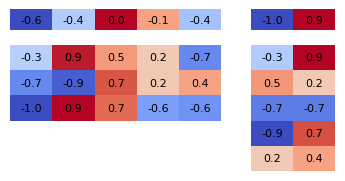

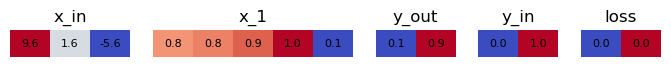

{'x_in': array([[ 9.56,  1.65, -5.62]]), 'x_1': array([[0.77, 0.81, 0.88, 1.  , 0.06]]), 'y_out': array([[0.1 , 0.88]]), 'y_in': array([[0., 1.]]), 'loss': array([[0.01, 0.02]])}


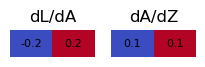

In [176]:
def get_data(df_xy_raw, x_cols,y_cols,extract=[0,1]):
    df_xy_raw = df_xy_raw.sample(frac=1, random_state=42).reset_index(drop=True)
    filter = df_xy_raw['Y'].isin(extract)
    df_xy_raw = df_xy_raw[filter]
    y_t = [y_cols[i] for i in y_cols if i in extract]
    # print(y_t)
    return df_xy_raw[x_cols], df_xy_raw[y_t]

def x_transform(df_x_train,n_pca=3):
    ss = sklearn.preprocessing.StandardScaler()
    df_X_train_ss = ss.fit_transform(df_x_train)
    # df_X_train_ss = df_x_train.copy(deep=True)
    # hm(df_X_train_ss)
    # display(pd.DataFrame(df_x_train).head())
    # display(pd.DataFrame(df_X_train_ss).head())

    # path 0
    pca = sklearn.decomposition.PCA(n_components=n_pca)

    df_X_train_pca = pca.fit_transform(df_X_train_ss)
    df_X_train_pca
    df_X_train_pca = pd.DataFrame(data = df_X_train_pca, columns = [f'PC{i}' for i in range(1,n_pca+1)])

    # ss = sklearn.preprocessing.StandardScaler()
    # principalDf = ss.fit_transform(principalDf)
    t = [i*100 for i in pca.explained_variance_ratio_]
    print('explained variance:', int(sum(t)))
    # print(pca.total_explained_variance_)
    # df_X_train_pca = df_X_train_pca.head(n_samples)
    # display(pd.DataFrame(df_X_train_pca))
    return df_X_train_pca

def get_arrays(df_x_pca, df_y_train,n_samples=5):
    X_train = df_x_pca.head(n_samples).values
    Y_train = df_y_train.head(n_samples).values
    return X_train, Y_train






def init_NN(layers):
    NN= {0:{'w':[],'b':[]}}
    # print(layers)
    n_out = None
    n_in = None
    for n in layers:
        if n_out == None:
            n_out = copy.deepcopy(n)
            continue
        else:
            n_in = copy.deepcopy(n_out)
            n_out = copy.deepcopy(n)

        # print('layer: ',n_in, n_out)
        np.random.seed(42)
        ar_w = np.random.uniform(-1, 1, (n_in, n_out))
        ar_b = np.random.uniform(-1, 1, (1, n_out))

        NN[0]['w'].append(ar_w)
        NN[0]['b'].append(ar_b)

    return NN

def forward_prop(arx,ary,net):
    n = net[len(net)-1]
    # print(len(net))
    # print(n)
    dict_r = {
        'x_in':copy.deepcopy(arx),
    }
    # hm(arx)
    for i,(w,b) in enumerate(zip(n['w'],n['b'])):
        if i!=0:
            dict_r[f'x_{i}'] = copy.deepcopy(arx)
        # print(w,b)
        # hm(arx)
        arx = arx @ w
        # hm(arx)
        arx = arx + b
        # hm(arx)
        # arx = sigmoid(arx)
        arx = sigmoid(arx)
        # hm(arx)
        
    dict_r['y_out'] = copy.deepcopy(arx)

    arL = arx-ary
    arL = arL**2
    dict_r['y_in'] = copy.deepcopy(ary)
    dict_r['loss'] = copy.deepcopy(arL)

    return dict_r



def sigmoid(df):
    return sp.special.expit(df)
def d_sigmoid(df):
    return df * (1 - df)
def d_loss(y,a):
    return 2*(y-a)


def diff(dict_forw):
    dict_r = {}
    print(dict_forw)
    dict_r['dL/dA'] = d_loss(dict_forw['y_in'],dict_forw['y_out'])
    dict_r['dA/dZ'] = d_sigmoid(dict_forw['y_out'])
    return dict_r

df_xy_raw, x_cols, y_cols = mnist_data()
df_x_train, df_y_train = get_data(df_xy_raw, x_cols,y_cols,extract=[0,1])
df_x_pca = x_transform(df_x_train,n_pca=3)
df_x_pca
ar_x_in, ar_y_in = get_arrays(df_x_pca, df_y_train,n_samples=1)
# hm_x([ar_x_in,ar_y_in])
Net = init_NN(layers=[ar_x_in.shape[1],5,ar_y_in.shape[1]])
hm_nn(Net[0])

forw1 = forward_prop(ar_x_in,ar_y_in,Net)
hm_x(list(forw1.values()),titles = list(forw1.keys()))

diff1 = diff(forw1)
hm_x(list(diff1.values()),titles = list(diff1.keys()))

# titles =  ['x_in'] +[i for i in range(len(t)-4)]+['y_pred','y_target','loss']
# print(titles)
# hm_x(t,titles = titles)
# hm_x(t,)

# forward_prop(ar_x_in,ar_y_in,Net)
# hm_x([ar_x_in,ar_y_in])
# Net

In [148]:
t.values()

dict_values([array([[  9.56,   1.65,  -5.62],
       [-12.75,   3.6 ,  -4.1 ],
       [  8.82,   1.59,  -6.63],
       [-15.37,  -5.54,   3.22],
       [  9.2 ,  -1.98,   9.71]]), array([[1.  , 0.  , 1.  , 0.  , 0.03],
       [0.  , 1.  , 0.03, 1.  , 0.99],
       [0.99, 0.  , 1.  , 0.  , 0.02],
       [0.  , 1.  , 0.  , 1.  , 0.99],
       [1.  , 0.  , 0.48, 0.28, 0.8 ]]), array([[0.35, 0.49],
       [0.18, 0.41],
       [0.36, 0.49],
       [0.18, 0.41],
       [0.29, 0.35]]), array([[0., 1.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [0., 1.]]), array([[0.13, 0.26],
       [0.68, 0.17],
       [0.13, 0.26],
       [0.68, 0.17],
       [0.08, 0.43]])])

In [144]:
Net

{0: {'w': [array([[ 0.44, -0.42,  0.83,  0.36,  0.7 ],
          [ 0.54, -0.64,  0.01, -0.44,  0.03],
          [-0.7 ,  0.44, -0.53,  0.98, -0.39]]),
   array([[-0.25, -0.97],
          [ 0.53,  0.1 ],
          [-0.8 ,  0.82],
          [ 0.31, -0.47],
          [ 0.58, -0.94]])],
  'b': [array([[-0.86, -0.  , -0.58,  0.08, -0.19]]), array([[-0.2,  0.3]])]}}

PCA(n_components=10)
explained variance: 41


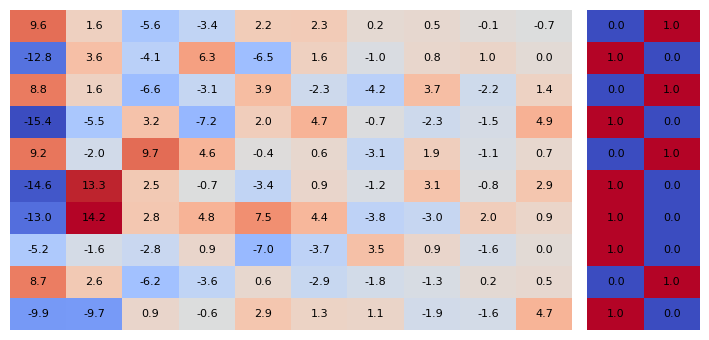

In [ ]:
def inverse_transform(df_x_pca,n):
    ss = sklearn.preprocessing.StandardScaler()
    df_X_train_ss = ss.fit_transform(df_x_train)




df_xy_raw, x_cols, y_cols = mnist_data()
df_x_train, df_y_train = get_data(df_xy_raw, x_cols,y_cols,extract=[0,1])
df_x_pca = x_transform(df_x_train,n_pca=10)
df_x_pca = df_x_pca.head(10)
df_y_train = df_y_train.head(10)
# hm(df_x_pca)
hm_x([df_x_pca, df_y_train])
# type(df_x_pca)


(60000, 28, 28)


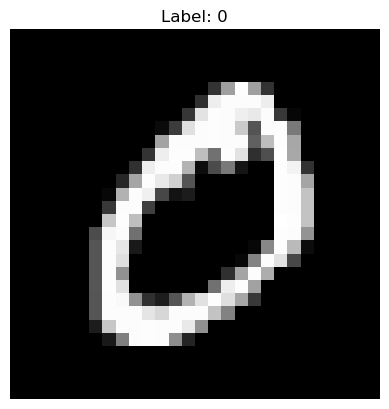

reshaped, sorted
ss
pca
(1, 784)
changed
inverse pca
inverse ss


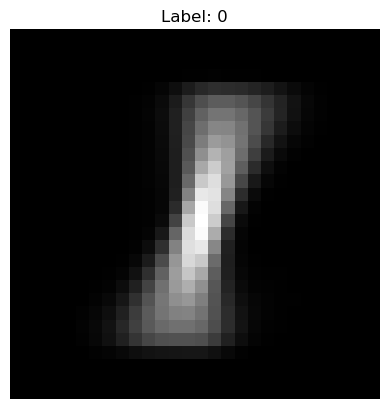

In [29]:
(x_t1, y_t1), (x_t0, y_t0) = tf.keras.datasets.mnist.load_data()

# isolate 0,1
print(x_t1.shape)
train_mask = (y_t1 == 0) | (y_t1 == 1)
# train_mask = train_mask  | (y_t1 == 2)
# train_mask = train_mask  | (y_t1 == 3)
# train_mask = train_mask  | (y_t1 == 4)
# train_mask = train_mask  | (y_t1 == 5)
# train_mask = train_mask  | (y_t1 == 6)
# train_mask = train_mask  | (y_t1 == 7)
# train_mask = train_mask  | (y_t1 == 8)
# train_mask = train_mask  | (y_t1 == 9)
# Apply masks
x_t6 = x_t1[train_mask]
y_t6 = y_t1[train_mask]

plt.imshow(x_t6[0], cmap='gray')
plt.title(f"Label: {y_t6[0]}")
plt.axis('off')
plt.show()



# reshape and sort cols
x_t4 = x_t6.reshape(x_t6.shape[0], 28*28)
c_t4 = x_t4.sum(axis=0)
i_t4 = np.argsort(c_t4)  # ascending
i_t4 = np.flip(i_t4)  # descending
x_t5 = x_t4[:, i_t4]
print('reshaped, sorted')
# display(pd.DataFrame(x_t5).head(4))


# ss
ss = sklearn.preprocessing.StandardScaler()
x_t2 = ss.fit_transform(x_t5)
print( 'ss')
# display(pd.DataFrame(x_t2).head(4))

# pca
pca = sklearn.decomposition.PCA(n_components=784)
x_t3 = pca.fit_transform(x_t2)
print('pca')
# display(pd.DataFrame(x_t3).head(4))

# change
# x_t3 = np.array([x_t3[0]])
filter = (y_t6 == 0)
filter = (y_t6 == 1)
# filter = (y_t6 == 2)
# filter = (y_t6 == 3)
x_t3 = x_t3[filter]
x_t3 = x_t3.mean(axis=0, keepdims=True)
print(x_t3.shape)

print('changed')
# display(pd.DataFrame(x_t3).head(4))

# inverse pca
x_t7 = pca.inverse_transform(x_t3)
print('inverse pca')
# display(pd.DataFrame(x_t7).head(4))

# inverse ss
x_t8 = ss.inverse_transform(x_t7)
print('inverse ss')
# display(pd.DataFrame(x_t8).head(4))\

# === Reverse sorting ===
# Get the inverse of the sorted indices
i_t8 = np.argsort(i_t4)

# Apply to go back to original order
x_t8 = x_t8[:, i_t8]

plt.imshow(x_t8[0].reshape(28,28), cmap='gray')
plt.title(f"Label: {y_t6[0]}")
plt.axis('off')
plt.show()

included: [0, 1, 2, 3]
pca [17, 24]
mean: 0 (5923, 784)
#################### [-1025, 84]
mean: 1 (6742, 784)
#################### [887, -30]
mean: 2 (5958, 784)
#################### [1, -483]
mean: 3 (6131, 784)
#################### [12, 422]


,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0,600,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


inverse pca


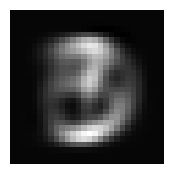

In [128]:
def img(dfx,dfy=None,y=None,i=0):
    if isinstance(dfy,pd.DataFrame):
        filter = dfy[0]==y
        dfx = dfx[filter]
    else:
        pass
    image = dfx.iloc[i].to_numpy().reshape(28, 28)
    
    # Plot the image
    plt.figure(figsize=(2, 2))
    plt.imshow(image, cmap='gray')
    # plt.title(f"Label: {dfy.iloc[0, 0]}")
    plt.axis('off')
    plt.show()
(ar_x_raw, ar_y_raw), _ = tf.keras.datasets.mnist.load_data()
ar_x_flatten = ar_x_raw.reshape(ar_x_raw.shape[0], 28*28)

df_x_all = pd.DataFrame(ar_x_flatten)
df_x_all
df_y_all = pd.DataFrame(ar_y_raw)
df_y_all

l_y_working = [0,1,2,3]
print('included:',l_y_working)
filter = df_y_all[0].isin(l_y_working)
df_y_sample = df_y_all[filter].reset_index(drop=True)
df_x_sample = df_x_all[filter].reset_index(drop=True)

# img(df_x_sample,df_y_sample,y=1)
# print(df_x_sample.shape)

# pca
pca = sklearn.decomposition.PCA(n_components=784)
df_x_pca = pca.fit_transform(df_x_sample)
df_x_pca = pd.DataFrame(df_x_pca)
nt_pca=2
cum_var_5 = np.cumsum(pca.explained_variance_ratio_[:nt_pca])
print('pca',[int(v*100) for v in cum_var_5])

# display(df_x_pca.head(4))
for y_t in l_y_working:
    # change
    filter = df_y_sample[0]==y_t
    # filter = df_y_sample[0]==1
    # filter = df_y_sample[0]==2
    df_xm_t = df_x_pca[filter]
    print('mean:',y_t,df_xm_t.shape)
    df_xm_t = pd.DataFrame(df_xm_t.mean()).T
    t = df_xm_t.iloc[:, :nt_pca]
    t = t.values[0]
    t = [int(i) for i in t]
    print('#'*20,t)

df_xm = pd.DataFrame(0, index=df_xm_t.index, columns=df_xm_t.columns)
# df_xm.iloc[0, 0] = -1000
# df_xm.iloc[0, 0] = 1000

# 0,1,2: 0
df_xm.iloc[0, 0] = -1000
df_xm.iloc[0, 1] = -200
# 0,1,2: 1
df_xm.iloc[0, 0] = 900
df_xm.iloc[0, 1] = -200
# 0,1,2: 2
df_xm.iloc[0, 0] = 0
df_xm.iloc[0, 1] = 600

display(df_xm)


# inverse pca
df_xm_pca = pca.inverse_transform(df_xm)
df_xm_pca = pd.DataFrame(df_xm_pca)

print('inverse pca')
# display(df_xm_pca.head(4))
img(df_xm_pca)


In [104]:

# t = gen_x_rev(df_xm,1,2)
# t.shape

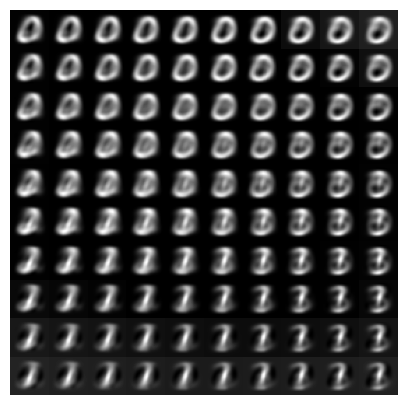

In [140]:
def plot_5x5_grid(data_25):
    n = len(data_25)
    n = n**0.5
    n = int(n)
    # print(n)
    fig, axes = plt.subplots(n, n, figsize=(5, 5))
    # fig.tight_layout(pad=0.0)
    # plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.subplots_adjust(wspace=0,hspace=0)

    for i, ax in enumerate(axes.flat):
        image = data_25[i].reshape(28, 28)
        ax.imshow(image, cmap='gray')
        ax.axis('off')

    plt.show()
def gen_x_rev(df_xm,l):

    df_xm = pd.DataFrame(0, index=df_xm_t.index, columns=df_xm_t.columns)
    for a,b in enumerate(l):
        # print(a,b)
        df_xm.iloc[0, a] = int(b)

    # df_xm.iloc[0, 0] = a
    # df_xm.iloc[0, 1] = b
        
    # display(df_xm)
    
    
    # inverse pca
    df_xm_pca = pca.inverse_transform(df_xm)
    df_xm_pca = pd.DataFrame(df_xm_pca)
    
    # print('inverse pca')
    # display(df_xm_pca.head(4))
    # img(df_xm_pca)
    return df_xm_pca.values
l_x_25 = []
# for i in np.linspace(-1000, 1000, 5):
#     for j in np.linspace(-200, 600, 5):
for i in np.linspace(-1050, 900, 10):
    for j in np.linspace(-500, 450, 10):
        l_x_25.append(gen_x_rev(df_xm_t,[i,j]))
plot_5x5_grid(l_x_25)

In [79]:
len(x_cols)

784

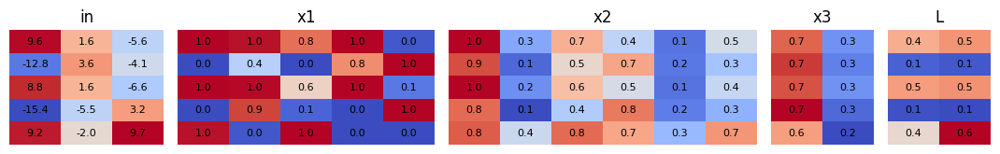

In [ ]:

    # pass
t = forward_prop(ar_x_in,ar_y_in,Net)
hm_x(t,titles = 'in,x1,x2,x3,L'.split(','))
#     print(df_y.shape, df_w.shape)
#     df_y = df_y @ df_w
#     print('y: dot')
#     display(pd.DataFrame(df_y))
#     df_y = df_y + df_b
#     print('y: bias')
#     display(pd.DataFrame(df_y))

#     df_y = sigmoid(df_y)
#     print('y: sigmoid')
#     display(pd.DataFrame(df_y))


# df_y.shape
# df_loss = df_y - df_y_e
# print('loss: ')
# display(pd.DataFrame(df_loss))
# df_loss = df_loss**2
# print('loss sq: ')
# display(pd.DataFrame(df_loss))
# print('loss sum: ',df_loss.sum())

In [ ]:
# for i in Net[0]['w']:
#     print(i)
# for i in Net[0]['b']:
#     print(i)

# plot_figures_row(Net[0]['w'])
# plot_figures_row(Net[0]['b'])
# plot_figures_row([np.zeros([4,4]) for i in range(4)] )

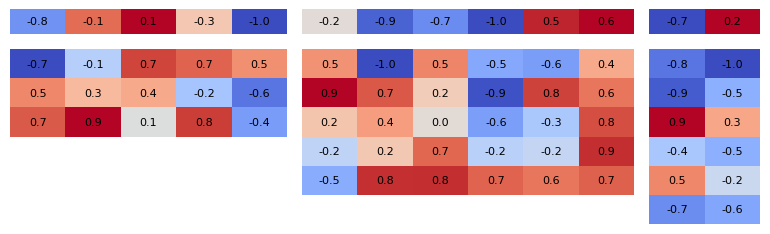

In [ ]:
from operator import le

hm_nn(Net[0])

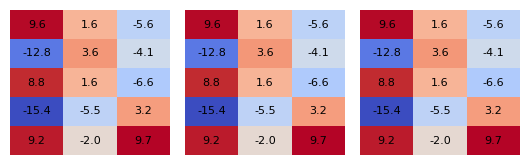

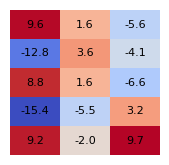

In [ ]:
import matplotlib.pyplot as plt


    # plt.close(fig)  # Prevents immediate display in Jupyter environments
    # return fig

hm_x([ar_x_in for i in range(3)])
hm_x([ar_x_in for i in range(1)])

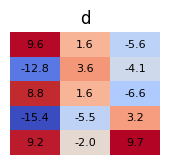

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt



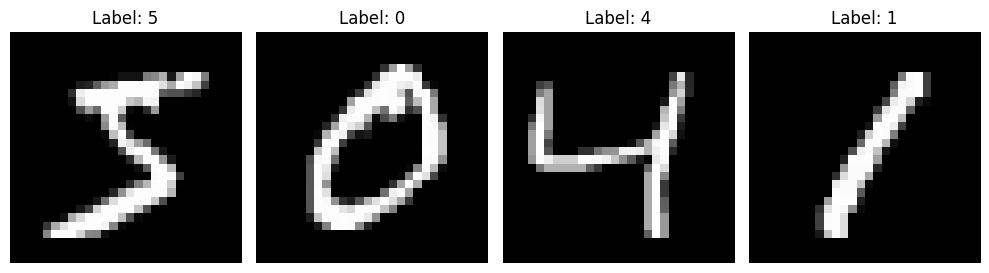

In [ ]:
# path 0
# Load the MNIST dataset

# Print 4 images in a row


,X_0,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,X_9,...,X_775,X_776,X_777,X_778,X_779,X_780,X_781,X_782,X_783,Y
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
14,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59972,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59979,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
59984,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
59987,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


,X_0,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,X_9,...,X_774,X_775,X_776,X_777,X_778,X_779,X_780,X_781,X_782,X_783
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59972,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59979,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59984,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
59987,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# path 0


,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12661,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12662,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12663,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


27.00121997492603 [np.float64(16.22625000633341), np.float64(6.502117815988118), np.float64(4.272852152604505)]


,PC1,PC2,PC3
0,-8.313959,-6.098147,-1.375302
1,8.713123,-1.182180,9.695846
2,7.689130,2.734244,-8.357074
3,8.509911,2.537255,-6.453394
4,8.682881,2.820767,-5.724683
...,...,...,...
12660,-7.845524,-14.136235,1.155638
12661,9.053607,0.332271,6.689302
12662,7.232413,-1.907430,8.901760
12663,-8.640372,-12.881881,5.517720


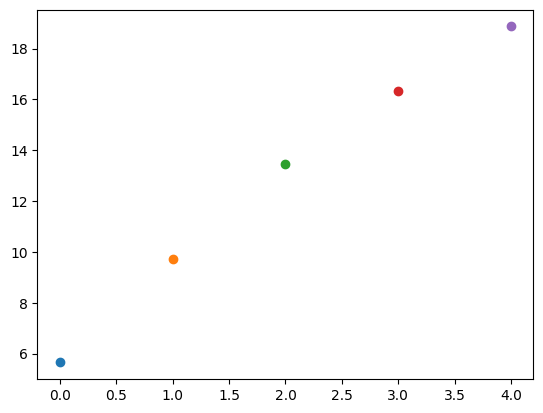

In [ ]:
k=0
for n,i in enumerate(t):
    k+=i
    # plt.scatter(n,i)
    plt.scatter(n,k)
    # print(n,i)
    # plt.text(n,i,str(i))
# plt.x_tics(range(len(t)))
plt.show()

2


,0,1
0,1.0,0.0
1,0.0,1.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0
...,...,...
12660,1.0,0.0
12661,0.0,1.0
12662,0.0,1.0
12663,1.0,0.0


In [ ]:
# t = np.array([[1,2,3],[4,5,6]])
# display(pd.DataFrame(t))

In [ ]:
# path 0
n_samples = 5

df_y = df_X_train_pca.head(n_samples).values
print('y: in')

display(pd.DataFrame(df_y))

df_y_e = df_y_train.head(n_samples).values
print('y: target')

display(pd.DataFrame(df_y_e))
layers = [n_pca,n_y]
n_out = None
n_in = None
for n in layers:
    if n_out == None:
        n_out = copy.deepcopy(n)
        continue
    else:
        n_in = copy.deepcopy(n_out)
        n_out = copy.deepcopy(n)

    print('layer: ',n_in, n_out)

    df_w = np.random.uniform(-1, 1, (n_in, n_out))
    df_b = np.random.uniform(-1, 1, (1, n_out))
    # display(pd.DataFrame(df_w))
    # display(pd.DataFrame(df_b))

    print(df_y.shape, df_w.shape)
    df_y = df_y @ df_w
    print('y: dot')
    display(pd.DataFrame(df_y))
    df_y = df_y + df_b
    print('y: bias')
    display(pd.DataFrame(df_y))

    df_y = sigmoid(df_y)
    print('y: sigmoid')
    display(pd.DataFrame(df_y))


df_y.shape
df_loss = df_y - df_y_e
print('loss: ')
display(pd.DataFrame(df_loss))
df_loss = df_loss**2
print('loss sq: ')
display(pd.DataFrame(df_loss))
print('loss sum: ',df_loss.sum())
# t = np.random.uniform(-1,1,(2,3))
# pd.DataFrame(t)+[2,2,2]

y: in


,0,1,2
0,-8.313959,-6.098147,-1.375302
1,8.713123,-1.182180,9.695846
2,7.689130,2.734244,-8.357074
3,8.509911,2.537255,-6.453394
4,8.682881,2.820767,-5.724683


y: target


,0,1
0,1.0,0.0
1,0.0,1.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0


layer:  3 2
(5, 3) (3, 2)
y: dot


,0,1
0,2.330037,5.801372
1,-8.659515,5.807978
2,-2.626026,-9.560244
3,-3.646258,-8.264932
4,-3.696416,-8.035631


y: bias


,0,1
0,3.314108,5.919795
1,-7.675444,5.926401
2,-1.641955,-9.441822
3,-2.662187,-8.146509
4,-2.712345,-7.917208


y: sigmoid


,0,1
0,0.964910,0.997321
1,0.000464,0.997339
2,0.162199,0.000079
3,0.065242,0.000290
4,0.062249,0.000364


loss: 


,0,1
0,-0.035090,0.997321
1,0.000464,-0.002661
2,0.162199,-0.999921
3,0.065242,-0.999710
4,0.062249,-0.999636


loss sq: 


,0,1
0,1.231334e-03,0.994650
1,2.151747e-07,0.000007
2,2.630860e-02,0.999841
3,4.256495e-03,0.999421
4,3.874915e-03,0.999272


loss sum:  4.028862369226743


In [ ]:
df_Y_train = pd.DataFrame([
    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
    ['red', 'green', 'blue', 'yellow', 'purple', 'orange', 'pink', 'brown', 'gray', 'cyan'],
]).T
df_Y_train.columns = ['y', 'y_color']
df_Y_train


,y,y_color
0,0,red
1,1,green
2,2,blue
3,3,yellow
4,4,purple
5,5,orange
6,6,pink
7,7,brown
8,8,gray
9,9,cyan


In [ ]:
PCA_res = pd.DataFrame(principalDf,columns=['PC1','PC2','PC3'])
PCA_res['y'] = Y_train
PCA_res = pd.merge(PCA_res, df_Y_train, on='y')
PCA_res

,PC1,PC2,PC3,y,y_color
0,-0.144927,-0.890389,0.013048,5,orange
1,1.368704,-1.434005,-0.665881,0,red
2,0.365930,1.744117,-1.194313,4,purple
3,-1.034455,-0.692799,0.712799,1,green
4,-0.814600,0.579434,-1.212434,9,cyan
...,...,...,...,...,...
59995,-0.320503,-0.946669,0.072473,8,gray
59996,0.095528,-1.201743,0.677351,3,yellow
59997,-0.593627,-0.597421,-0.735076,5,orange
59998,0.270688,-0.915046,0.001342,6,pink


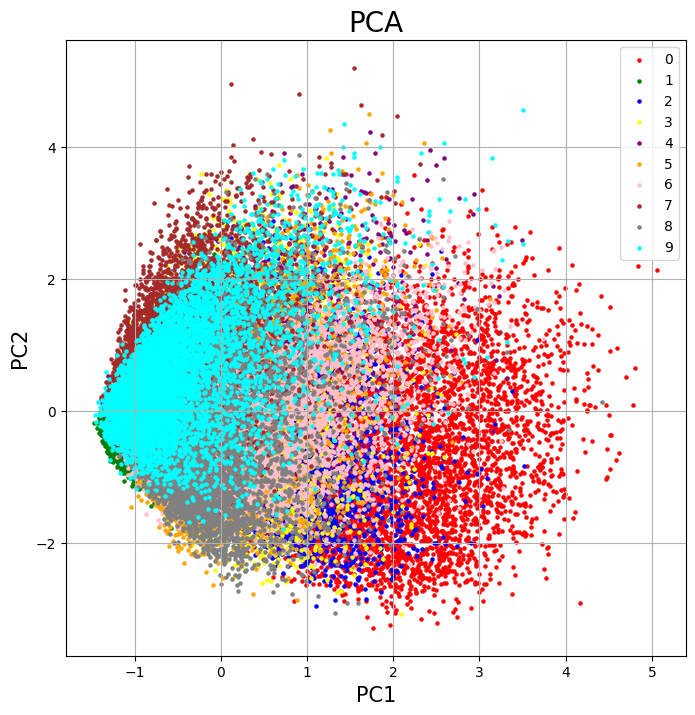

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('PC1', fontsize = 15)
ax.set_ylabel('PC2', fontsize = 15)
ax.set_title('PCA', fontsize = 20)

for index,row in df_Y_train.iterrows():
    indicesToKeep = PCA_res['y'] == row['y']
    ax.scatter(PCA_res.loc[indicesToKeep, 'PC1']
               , PCA_res.loc[indicesToKeep, 'PC2']
               , c = row['y_color']
               , s = 5)
ax.legend(df_Y_train['y'])
ax.grid()

In [ ]:
import datetime
from datetime import date
import pandas as pd
import numpy as np
from plotly import __version__
%matplotlib inline

import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import iplot

import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


cf.go_offline()
init_notebook_mode(connected=False)
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import plotly.express as px
configure_plotly_browser_state()
filter = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# filter = [8, 9]
# filter = [1, 7, 9]
filter = PCA_res['y'].isin(filter)
fig = px.scatter_3d(PCA_res[filter], x='PC1', y='PC2', z='PC3',
              color='y')
fig.show()

In [ ]:

df_t = PCA_res.copy(deep=True)
for index, row in df_Y_train.iterrows():
    filter = df_t['y']==row['y']
    df_t.loc[filter, 'PC1'] += row['y']*4
df_t['size']=1
configure_plotly_browser_state()
fig = px.scatter_3d(df_t, x='PC1', y='PC2', z='PC3',
              color='y',size='size')
fig.show()

In [ ]:
PCA_res

,PC1,PC2,PC3,y,y_color
0,-0.922159,-4.814790,0.067560,5,orange
1,8.708977,-7.754403,-3.447910,0,red
2,2.328389,9.431338,-6.184114,4,purple
3,-6.582173,-3.746318,3.690851,1,green
4,-5.183251,3.133297,-6.277947,9,cyan
...,...,...,...,...,...
59995,-2.039339,-5.119129,0.375261,8,gray
59996,0.607841,-6.498440,3.507305,3,yellow
59997,-3.777212,-3.230564,-3.806199,5,orange
59998,1.722369,-4.948125,0.006951,6,pink
